# Olist : Build a customer segmentation model

### Loading project modules

* NumPy and Pandas: to perform scientific calculations (statistics, algebra, ...) and manipulate large and complex data series and tables
* scikit-learn: to model data
* Plotly: to generate readable, interactive and relevant graphs

In [1]:
# System modules
import os
import sys
from time import time

# Append source directory to system path
src_path = os.path.abspath(os.path.join("../src"))
if src_path not in sys.path:
    sys.path.append(src_path)

# Helper functions
# import data.helpers as data_helpers

# numpy and pandas for data manipulation
import numpy as np
import pandas as pd

# matplotlib and seaborn for plotting
import plotly.express as px
import plotly.graph_objects as go

# Necessary to export to HTML
import plotly.io as pio
pio.renderers.default='jupyterlab' # 'notebook' for Jupyter Notebook
import plotly as py
py.offline.init_notebook_mode()


# Accelerate the development cycle
SAMPLE_FRAC: float = 0.5

# # Prevent excessive memory usage used by plotly
# DRAW_PLOTS: bool = True

### Loading the data
We will download and unzip the CSV files, then load them into memory, taking care to use the right type for each variable.

The data schema is given to us, and we added the dataframe name of each of it:

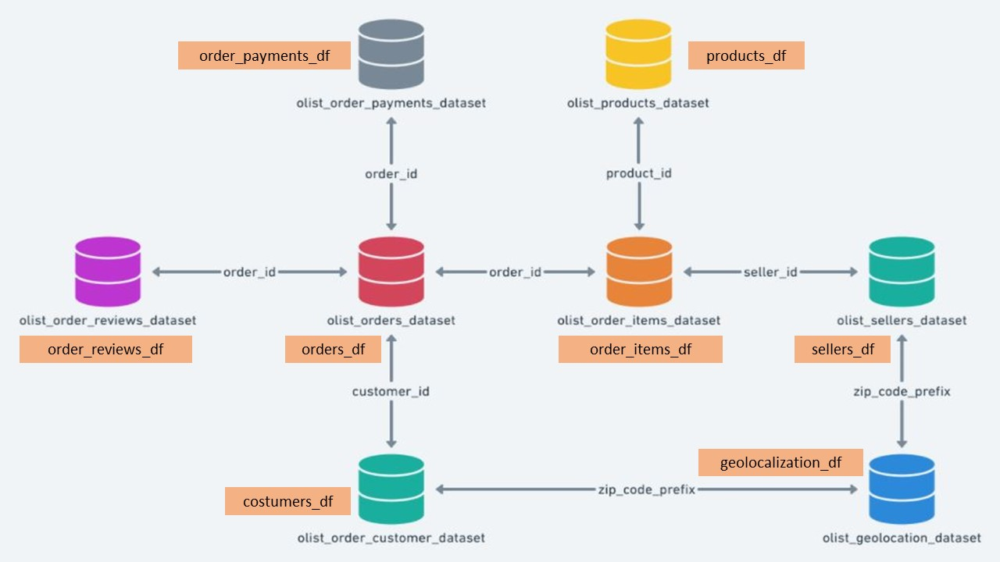

### Chargement des données

In [2]:
# Load customers data
customers_df = pd.read_csv(
    "../data/raw/olist_customers_dataset.csv",
    dtype={
        # Nominal qualitative data
        "customer_id": "category",
        "customer_unique_id": "category",
        "customer_city": "category",
        "customer_state": "category",
        "customer_zip_code_prefix": "category",
    },
)

# Load geolocation data
geolocation_df = pd.read_csv(
    "../data/raw/olist_geolocation_dataset.csv",
    dtype={
        # Nominal qualitative data
        "geolocation_zip_code_prefix": "category",
        "geolocation_city": "category",
        "geolocation_state": "category",
        # Continuous quantitative data
        "geolocation_lat": float,
        "geolocation_lng": float,
    },
)

# Load order items data
order_items_df = pd.read_csv(
    "../data/raw/olist_order_items_dataset.csv",
    dtype={
        # Nominal qualitative data
        "order_id": "category",
        "order_item_id": "category",
        "product_id": "category",
        "seller_id": "category",
        # Date data
        "shipping_limit_date": str,
        # Continuous quantitative data
        "price": float,
        "freight_value": float,
    },
    parse_dates=["shipping_limit_date"],
)

# Load order payments
order_payments_df = pd.read_csv(
    "../data/raw/olist_order_payments_dataset.csv",
    dtype={
        # Nominal qualitative data
        "order_id": "category",
        "payment_type": "category",
        # Discrete quantitative data
        "payment_sequential": int,
        "payment_installments": int,
        # Continuous quantitative data
        "payment_value": float,
    },
)

# Load order reviews
order_reviews_df = pd.read_csv(
    "../data/raw/olist_order_reviews_dataset.csv",
    dtype={
        # Nominal qualitative data
        "review_id": "category",
        "order_id": "category",
        # Discrete quantitative data
        "review_score": int,
        # Text data
        "review_comment_title": str,
        "review_comment_message": str,
        # Date data
        "review_creation_date": str,
        "review_answer_timestamp": str,
    },
    parse_dates=["review_creation_date", "review_answer_timestamp"],
)

# Load orders data
orders_df = pd.read_csv(
    "../data/raw/olist_orders_dataset.csv",
    dtype={
        # Nominal qualitative data
        "order_id": "category",
        "customer_id": "category",
        "order_status": "category",
        # Date data
        "order_purchase_timestamp": str,
        "order_approved_at": str,
        "order_delivered_carrier_date": str,
        "order_delivered_customer_date": str,
        "order_estimated_delivery_date": str,
    },
    parse_dates=[
        "order_purchase_timestamp",
        "order_approved_at",
        "order_delivered_carrier_date",
        "order_delivered_customer_date",
        "order_estimated_delivery_date",
    ],
)

# Load products data
products_df = pd.read_csv(
    "../data/raw/olist_products_dataset.csv",
    dtype={
        # Nominal qualitative data
        "product_id": "category",
        "product_category_name": "category",
        # Discrete quantitative data
        # Nullable : https://pandas.pydata.org/pandas-docs/stable/user_guide/gotchas.html#support-for-integer-na
        "product_name_lenght": pd.Int64Dtype(),
        "product_description_lenght": pd.Int64Dtype(),
        "product_photos_qty": pd.Int64Dtype(),
        # Continuous quantitative data
        "product_weight_g": float,
        "product_length_cm": float,
        "product_height_cm": float,
        "product_width_cm": float,
    },
)

# Load sellers data
sellers_df = pd.read_csv(
    "../data/raw/olist_sellers_dataset.csv",
    dtype={
        # Nominal qualitative data
        "seller_id": "category",
        "seller_city": "category",
        "seller_state": "category",
        "seller_zip_code_prefix": "category",
    },
)

# Load category name translation data
category_translation_df = pd.read_csv(
    "../data/raw/product_category_name_translation.csv"
)

In [3]:
# data
app_df = pd.read_csv('../data/raw/olist_customers_dataset.csv')
print('Data shape: ', app_df.shape)
app_df.head()

Data shape:  (99441, 5)


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [4]:
print(customers_df.shape)
customers_df.head()

(99441, 5)


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [5]:
print(geolocation_df.shape)
geolocation_df.head()

(1000163, 5)


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,01037,-23.545621,-46.639292,sao paulo,SP
1,01046,-23.546081,-46.644820,sao paulo,SP
2,01046,-23.546129,-46.642951,sao paulo,SP
3,01041,-23.544392,-46.639499,sao paulo,SP
4,01035,-23.541578,-46.641607,sao paulo,SP


In [6]:
print(orders_df.shape)
orders_df.head()

(99441, 8)


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26


In [7]:
geolocation_df.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,01037,-23.545621,-46.639292,sao paulo,SP
1,01046,-23.546081,-46.644820,sao paulo,SP
2,01046,-23.546129,-46.642951,sao paulo,SP
3,01041,-23.544392,-46.639499,sao paulo,SP
4,01035,-23.541578,-46.641607,sao paulo,SP


In [8]:
sellers_df.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,04195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


### Merging datasets
We will merge al the important dataframes based on the key connecting variables between them

In [9]:
##Instead of working with one by one of them, we concatenate all the dataframes into one
# # we have to use .merge

#costomers_df, geolocation_df, order_items_df, order_payments_df, order_reviews_df, orders_df, products_df, sellers_df, category_translation_df])
# dfs_concat

#it doens't work properly, so we will try .merge

In [10]:
#We check the shape of each dataframe
dfs=[customers_df, orders_df]#, geolocation_df, order_items_df, order_payments_df, order_reviews_df, products_df, sellers_df, category_translation_df]
for df in dfs:
    print(df.shape)

(99441, 5)
(99441, 8)


In [11]:
import pandas as pd
from functools import reduce

df_merged_costumer_id = reduce(lambda left,right: pd.merge(left,right,on=['customer_id'], how='outer'), dfs)

In [12]:
df_merged_costumer_id

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15
...,...,...,...,...,...,...,...,...,...,...,...,...
99436,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,03937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,2018-04-13 20:06:37,2018-04-25
99437,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,06764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,2018-04-11 18:54:45,2018-04-20
99438,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,2018-05-09 19:03:15,2018-05-02
99439,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,2017-11-16 19:58:39,2017-12-05


In [13]:
import pandas as pd
from functools import reduce

df_order_id= [orders_df, order_items_df, order_payments_df, order_reviews_df]
df_merged_order_id = reduce(lambda left,right: pd.merge(left,right,on=['order_id'], how='outer'), df_order_id)

df_merged_order_id 

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,payment_sequential,payment_type,payment_installments,payment_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,1.0,credit_card,1.0,18.12,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11,2017-10-12 03:43:48
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,3.0,voucher,1.0,2.00,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11,2017-10-12 03:43:48
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,2.0,voucher,1.0,18.59,a54f0611adc9ed256b57ede6b6eb5114,4.0,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11,2017-10-12 03:43:48
3,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,1,595fac2a385ac33a80bd5114aec74eb8,...,1.0,boleto,1.0,141.46,8d5266042046a06655c8db133d120ba5,4.0,Muito boa a loja,Muito bom o produto.,2018-08-08,2018-08-08 18:37:50
4,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,1,aa4383b373c6aca5d8797843e5594415,...,1.0,credit_card,3.0,179.12,e73b67b67587f7644d5bd1a52deb1b01,5.0,NaN,NaN,2018-08-18,2018-08-22 19:07:58
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02,1,f1d4ce8c6dd66c47bbaa8c6781c2a923,...,1.0,credit_card,3.0,195.00,29bb71b2760d0f876dfa178a76bc4734,4.0,NaN,So uma peça que veio rachado mas tudo bem rs,2018-03-01,2018-03-02 17:50:01
119139,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27,1,b80910977a37536adeddd63663f916ad,...,1.0,credit_card,5.0,271.01,371579771219f6db2d830d50805977bb,5.0,NaN,Foi entregue antes do prazo.,2017-09-22,2017-09-22 23:10:57
119140,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,1,d1c427060a0f73f6b889a5c7c61f2ac4,...,1.0,credit_card,4.0,441.16,8ab6855b9fe9b812cd03a480a25058a1,2.0,NaN,Foi entregue somente 1. Quero saber do outro p...,2018-01-26,2018-01-27 09:16:56
119141,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,2,d1c427060a0f73f6b889a5c7c61f2ac4,...,1.0,credit_card,4.0,441.16,8ab6855b9fe9b812cd03a480a25058a1,2.0,NaN,Foi entregue somente 1. Quero saber do outro p...,2018-01-26,2018-01-27 09:16:56


In [14]:
import pandas as pd
from functools import reduce

df_product_id = [df_merged_order_id, products_df]
df_merged_product_id = reduce(lambda left,right: pd.merge(left,right,on=['product_id'], how='outer'), df_product_id)

df_merged_product_id

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,2017-10-11,2017-10-12 03:43:48,utilidades_domesticas,40,268,4,500.0,19.0,8.0,13.0
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,2017-10-11,2017-10-12 03:43:48,utilidades_domesticas,40,268,4,500.0,19.0,8.0,13.0
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,...,2017-10-11,2017-10-12 03:43:48,utilidades_domesticas,40,268,4,500.0,19.0,8.0,13.0
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28,1,87285b34884572647811a353c7ac498a,...,2017-08-19,2017-08-20 15:16:36,utilidades_domesticas,40,268,4,500.0,19.0,8.0,13.0
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15,1,87285b34884572647811a353c7ac498a,...,2017-08-08,2017-08-08 23:26:23,utilidades_domesticas,40,268,4,500.0,19.0,8.0,13.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31,1,0df37da38a30a713453b03053d60d3f7,...,2017-08-24,2017-08-25 11:38:19,esporte_lazer,53,1105,1,2800.0,28.0,23.0,23.0
119139,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31,2,0df37da38a30a713453b03053d60d3f7,...,2017-08-24,2017-08-25 11:38:19,esporte_lazer,53,1105,1,2800.0,28.0,23.0,23.0
119140,cfa78b997e329a5295b4ee6972c02979,a2f7428f0cafbc8e59f20e1444b67315,delivered,2017-12-20 09:52:41,2017-12-20 10:09:52,2017-12-20 20:25:25,2018-01-26 15:45:14,2018-01-18,1,3d2c44374ee42b3003a470f3e937a2ea,...,2018-01-19,2018-01-21 02:51:39,instrumentos_musicais,34,372,2,300.0,16.0,6.0,12.0
119141,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28,1,ac35486adb7b02598c182c2ff2e05254,...,2017-03-22,2017-03-23 11:02:08,beleza_saude,50,1517,1,1175.0,22.0,13.0,18.0


In [15]:
# import pandas as pd
# from functools import reduce

# df_zip_code_prefix = [df_merged_costumer_id, geolocation_df, sellers_df]
# df_merged_zip_code_prefix = reduce(lambda left,right: pd.merge(left,right,on=['geolocation_zip_code_prefix'], how='outer'), df_zip_code_prefix)

# df_merged_zip_code_prefix

## Zip_code has different names in dfs, so I won't use it. 

In [16]:
#we check the type of the variables
df_merged_product_id.dtypes.astype(str).value_counts()

float64           10
category           8
datetime64[ns]     8
object             3
Int64              3
dtype: int64

In [17]:
df_merged_costumer_id.dtypes.astype(str).value_counts()

category          7
datetime64[ns]    5
dtype: int64

In [18]:
df_merged_product_id.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm'],
      dtype='object')

In [19]:
df_merged_costumer_id.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date'],
      dtype='object')

In [20]:
import pandas as pd
from functools import reduce

dfs= [df_merged_costumer_id, df_merged_product_id]
dfs_merged = reduce(lambda left,right: pd.merge(left,right,on=['order_id'], how='outer'), dfs)

dfs_merged

,customer_id_x,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status_x,order_purchase_timestamp_x,order_approved_at_x,order_delivered_carrier_date_x,...,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,2017-05-26,2017-05-30 22:34:40,moveis_escritorio,41,1141,1,8683.0,54.0,64.0,31.0
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,2018-01-30,2018-02-10 22:43:29,utilidades_domesticas,43,1002,3,10150.0,89.0,15.0,40.0
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,2018-06-15,2018-06-15 12:10:59,moveis_escritorio,55,955,1,8267.0,52.0,52.0,17.0
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,2018-03-29,2018-04-02 18:36:47,moveis_escritorio,48,1066,1,12160.0,56.0,51.0,28.0
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,2018-08-10,2018-08-17 01:59:52,casa_conforto,61,407,1,5200.0,45.0,15.0,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,03937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,...,2018-04-14,2018-04-28 11:15:04,livros_interesse_geral,51,489,2,611.0,22.0,22.0,23.0
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,06764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,...,2018-04-12,2018-04-16 10:36:05,esporte_lazer,51,1193,1,1211.0,25.0,24.0,22.0
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,...,2018-05-04,2018-05-08 01:41:07,beleza_saude,60,575,1,870.0,25.0,20.0,18.0
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,...,2017-11-17,2017-11-19 23:34:18,relogios_presentes,59,452,1,710.0,19.0,13.0,14.0


In [21]:
# app_df.describe(include="bool")

In [22]:
# We check the info of each variable
dfs_merged.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 119143 entries, 0 to 119142
Data columns (total 43 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   customer_id_x                    119143 non-null  category      
 1   customer_unique_id               119143 non-null  category      
 2   customer_zip_code_prefix         119143 non-null  category      
 3   customer_city                    119143 non-null  category      
 4   customer_state                   119143 non-null  category      
 5   order_id                         119143 non-null  object        
 6   order_status_x                   119143 non-null  category      
 7   order_purchase_timestamp_x       119143 non-null  datetime64[ns]
 8   order_approved_at_x              118966 non-null  datetime64[ns]
 9   order_delivered_carrier_date_x   117057 non-null  datetime64[ns]
 10  order_delivered_customer_date_x  115722 non-

The training data has 119143 observations and 43 features (variables).
Among these variables, we have :

* 3 object variables
* 14 categorical variables
* 13 numerical variables
* 13 datetime64 variables


#### Exploratory analysis

We will analyse the distribution of some variables.

#### Target variable
Let us look specifically at the distribution of the TARGET variable, which is the one we will have to estimate later. The zero values represent our training set. We can see that we are dealing with an unbalanced binary classification problem (there are two possible values, but both values are not equally represented). This will influence the way we build and train our model.

In [23]:
app_df['customer_city'].value_counts()

sao paulo            15540
rio de janeiro        6882
belo horizonte        2773
brasilia              2131
curitiba              1521
                     ...  
bequimao                 1
andarai                  1
vargem grande            1
curvelandia              1
eugenio de castro        1
Name: customer_city, Length: 4119, dtype: int64

#### Empty values
We see that all variables have less than 30% empty values, and almost half have less than 1% empty values. The dataset is therefore relatively well filled, which should not be a problem for the next step.

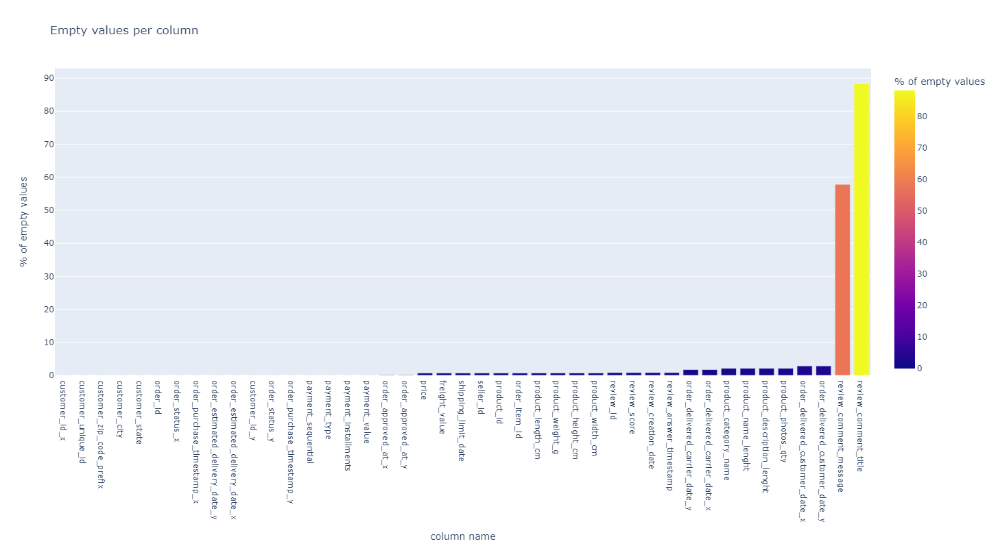

In [24]:
def plot_empty_values(dataframe: pd.DataFrame) -> None:
    """
    Plot a histogram of empty values percentage per columns of the input
    DataFrame.
    Args:|
        dataframe: The DataFrame to plot.
    Returns:
        None.
    """
    num_rows = len(dataframe.index)
    if num_rows == 0:
        logging.warning("No data to plot.")
        return

    # Get the percentage of empty values per column
    columns_emptiness = (
        pd.DataFrame(
            {
                col: {
                    "count": dataframe[col].isna().sum(),
                    "percent": 100 * dataframe[col].isna().sum() / num_rows,
                }
                for col in dataframe.columns
            }
        )
        .transpose()
        .sort_values(by=["count"])
    )

    # Plot the bar chart with Plotly Express
    fig = px.bar(
        columns_emptiness,
        color="percent",
        y="percent",
        labels={
            "index": "column name",
            "percent": "% of empty values",
            "count": "# of empty values",
        },
        hover_data=["count"],
        title="Empty values per column",
        width=1200,
        height=800,
    )
    fig.show()

plot_empty_values(dfs_merged)

In [25]:
# Fonction pour calculer les valeurs manquantes
def missing_values_table(df):
        # Total valeurs manquantes
        mis_val = df.isnull().sum()
        
        # Pourcentage valeurs manquantes
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Table des résultats
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Renommer les colonnes
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Valeurs manquantes', 1 : 'Taux manquant'})
        
        # Trie
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        'Taux manquant', ascending=False).round(1)
        
        # Synthése
        print ("Quantity of columns  " + str(df.shape[1]) + " columns.\n"      
            "There is " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Retourne et affichage des résultats
        return mis_val_table_ren_columns


In [26]:
# Missing values ratio
missing_values = missing_values_table(dfs_merged)
missing_values.head(20)

Quantity of columns  43 columns.
There is 30 columns that have missing values.


,Valeurs manquantes,Taux manquant
review_comment_title,105154,88.3
review_comment_message,68898,57.8
order_delivered_customer_date_x,3421,2.9
order_delivered_customer_date_y,3421,2.9
product_name_lenght,2542,2.1
product_photos_qty,2542,2.1
product_category_name,2542,2.1
product_description_lenght,2542,2.1
order_delivered_carrier_date_y,2086,1.8
order_delivered_carrier_date_x,2086,1.8


41 variables have less than 3% of missing values and 2 of them (review_comment_message and review_comment_title) have more than 57 % of missing values. Those 2 we will eliminate.

In [27]:
# From the meaningful_data, Selection of fill columns and visualization of variables based on % of missing value

df_meaningful = dfs_merged[dfs_merged.columns[dfs_merged.isna().sum()/dfs_merged.shape[0] < 0.57]]
df_meaningful

,customer_id_x,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status_x,order_purchase_timestamp_x,order_approved_at_x,order_delivered_carrier_date_x,...,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,2017-05-26,2017-05-30 22:34:40,moveis_escritorio,41,1141,1,8683.0,54.0,64.0,31.0
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,09790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,2018-01-30,2018-02-10 22:43:29,utilidades_domesticas,43,1002,3,10150.0,89.0,15.0,40.0
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,01151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,2018-06-15,2018-06-15 12:10:59,moveis_escritorio,55,955,1,8267.0,52.0,52.0,17.0
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,08775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,2018-03-29,2018-04-02 18:36:47,moveis_escritorio,48,1066,1,12160.0,56.0,51.0,28.0
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,2018-08-10,2018-08-17 01:59:52,casa_conforto,61,407,1,5200.0,45.0,15.0,35.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119138,17ddf5dd5d51696bb3d7c6291687be6f,1a29b476fee25c95fbafc67c5ac95cf8,03937,sao paulo,SP,6760e20addcf0121e9d58f2f1ff14298,delivered,2018-04-07 15:48:17,2018-04-07 16:08:45,2018-04-11 02:08:36,...,2018-04-14,2018-04-28 11:15:04,livros_interesse_geral,51,489,2,611.0,22.0,22.0,23.0
119139,e7b71a9017aa05c9a7fd292d714858e8,d52a67c98be1cf6a5c84435bd38d095d,06764,taboao da serra,SP,9ec0c8947d973db4f4e8dcf1fbfa8f1b,delivered,2018-04-04 08:20:22,2018-04-04 08:35:12,2018-04-05 18:42:35,...,2018-04-12,2018-04-16 10:36:05,esporte_lazer,51,1193,1,1211.0,25.0,24.0,22.0
119140,5e28dfe12db7fb50a4b2f691faecea5e,e9f50caf99f032f0bf3c55141f019d99,60115,fortaleza,CE,fed4434add09a6f332ea398efd656a5c,delivered,2018-04-08 20:11:50,2018-04-08 20:30:03,2018-04-09 17:52:17,...,2018-05-04,2018-05-08 01:41:07,beleza_saude,60,575,1,870.0,25.0,20.0,18.0
119141,56b18e2166679b8a959d72dd06da27f9,73c2643a0a458b49f58cea58833b192e,92120,canoas,RS,e31ec91cea1ecf97797787471f98a8c2,delivered,2017-11-03 21:08:33,2017-11-03 21:31:20,2017-11-06 18:24:41,...,2017-11-17,2017-11-19 23:34:18,relogios_presentes,59,452,1,710.0,19.0,13.0,14.0


In [28]:
# dfs_merged.drop(['review_comment_message','review_comment_title'], inplace=True, axis=1)

In [29]:
# Missing values ratio
missing_values = missing_values_table(df_meaningful)
missing_values.head(20)

Quantity of columns  41 columns.
There is 28 columns that have missing values.


,Valeurs manquantes,Taux manquant
order_delivered_customer_date_x,3421,2.9
order_delivered_customer_date_y,3421,2.9
product_name_lenght,2542,2.1
product_category_name,2542,2.1
product_photos_qty,2542,2.1
product_description_lenght,2542,2.1
order_delivered_carrier_date_y,2086,1.8
order_delivered_carrier_date_x,2086,1.8
review_answer_timestamp,997,0.8
review_creation_date,997,0.8


### First statistical analysis

Let's see what the distribution of the different variables is.

A simple statistical description of each column gives us the following information.

In [30]:
# Display statistical summary of each column
df_meaningful.describe(include="all", datetime_is_numeric=True)

,customer_id_x,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status_x,order_purchase_timestamp_x,order_approved_at_x,order_delivered_carrier_date_x,...,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,119143,119143,119143,119143,119143,119143,119143,119143,118966,117057,...,118146,118146,116601,116601.000000,116601.000000,116601.000000,118290.000000,118290.000000,118290.000000,118290.000000
unique,99441,96096,14994,4119,27,99441,8,NaN,NaN,NaN,...,NaN,NaN,73,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,270c23a11d024a44c896d1894b261a83,9a736b248f67d166d2fbb006bcb877c3,24220,sao paulo,SP,895ab968e7bb0d5659d16cd74cd1650c,delivered,NaN,NaN,NaN,...,NaN,NaN,cama_mesa_banho,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,63,75,164,18875,50265,63,115723,NaN,NaN,NaN,...,NaN,NaN,11988,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-12-29 18:36:13.115760384,2017-12-30 04:49:18.425726720,2018-01-03 08:24:34.395525376,...,2018-01-11 13:17:50.103092736,2018-01-14 17:00:35.769302528,NaN,48.767498,785.967822,2.205161,2112.250740,30.265145,16.619706,23.074799
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016-09-04 21:15:19,2016-09-15 12:16:38,2016-10-08 10:34:01,...,2016-10-02 00:00:00,2016-10-07 18:32:28,NaN,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2017-09-10 20:15:46,2017-09-11 15:50:48.500000,2017-09-14 19:52:12,...,2017-09-22 00:00:00,2017-09-25 11:15:40.750000128,NaN,42.000000,346.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018-01-17 11:59:12,2018-01-17 16:49:49,2018-01-23 17:03:08,...,2018-02-01 00:00:00,2018-02-03 12:04:23,NaN,52.000000,600.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018-05-03 13:18:30,2018-05-03 16:56:53,2018-05-07 14:57:00,...,2018-05-15 00:00:00,2018-05-17 10:48:59,NaN,57.000000,983.000000,3.000000,1800.000000,38.000000,20.000000,30.000000
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2018-10-17 17:30:18,2018-09-03 17:40:06,2018-09-11 19:48:28,...,2018-08-31 00:00:00,2018-10-29 12:27:35,NaN,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


#### Distribution of different values
Let's see how some variables are distributed.

#### Nominal categorical variable: product_category_name
Let's see how the product categories are distributed.

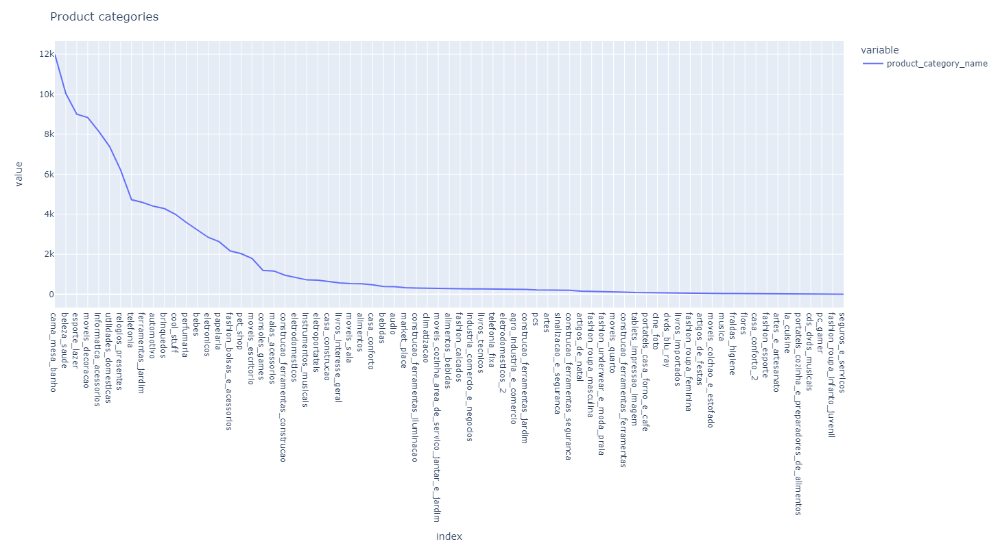

In [31]:
# Display the density of product categories
fig = px.line(df_meaningful['product_category_name'].value_counts())
fig.update_layout(
    title_text="Product categories",
    width=1200,
    height=800,
)
fig.show()

We can already see that there is a very uneven distribution of product categories and that categorisation should certainly be improved in order to avoid having a very large number of categories with only few elements.

In [32]:
df_meaningful['product_category_name']

0              moveis_escritorio
1          utilidades_domesticas
2              moveis_escritorio
3              moveis_escritorio
4                  casa_conforto
                   ...          
119138    livros_interesse_geral
119139             esporte_lazer
119140              beleza_saude
119141        relogios_presentes
119142                perfumaria
Name: product_category_name, Length: 119143, dtype: category
Categories (73, object): ['agro_industria_e_comercio', 'alimentos', 'alimentos_bebidas', 'artes', ..., 'tablets_impressao_imagem', 'telefonia', 'telefonia_fixa', 'utilidades_domesticas']

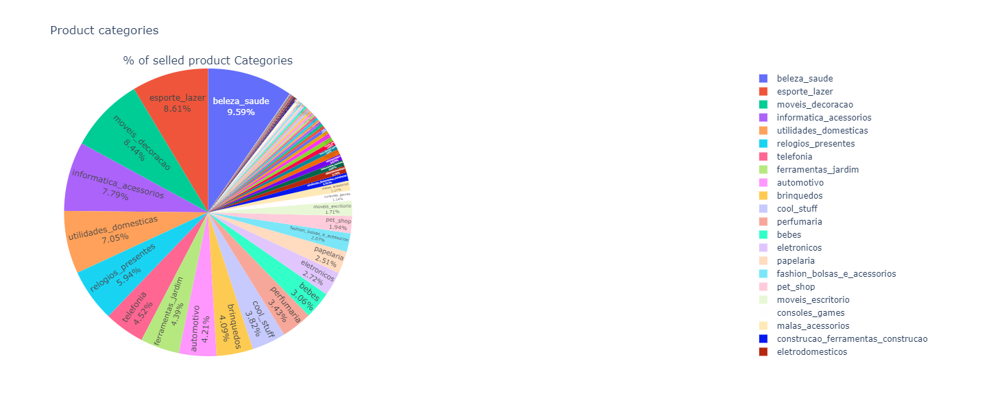

In [48]:
# Let's keep only the top values and merge the rest into "Other"
# df_meaningful.loc[:,'top_category'] = df_meaningful['product_category_name'].where(
#     df_meaningful['product_category_name'].isna() | df_meaningful['product_category_name'].isin(df_meaningful['product_category_name'].value_counts().index[:20]), 
#     other='other', 
# )

from plotly.subplots import make_subplots

fig = make_subplots(
    rows=1, cols=2, 
    subplot_titles=("% of selled product Categories", ), 
    specs=[[{'type':'domain'}, {'type':'domain'}]],
)
fig.add_trace(go.Pie(
    labels=df_meaningful['product_category_name'].value_counts().index[1:], 
    values=df_meaningful['product_category_name'].value_counts().values[1:], 
    name="Product_Category",
#     pull=[0.05 if cat == 'other' else 0 for cat in df_meaningful['top_category'].value_counts().index],
), row=1, col=1)

# fig.add_trace(go.Pie(
#     labels=df_meaningful['top_category'].value_counts().index[1:], 
#     values=df_meaningful['top_category'].value_counts().values[1:], 
#     name="Top 20",
# ), row=1, col=2)

fig.update_traces(
    textposition='inside',
    textinfo='percent+label'
)
fig.update_layout(
    title_text="Product categories",
    width=1200,
    height=600,
)
fig.show()

#### Total amount of money by payment modality

In [49]:
payment_type_df = df_meaningful.groupby("payment_type")["payment_value"].sum()
payment_type_df.head()

payment_type
boleto          4110920.74
credit_card    15775450.54
debit_card       257374.89
not_defined           0.00
voucher          435917.84
Name: payment_value, dtype: float64

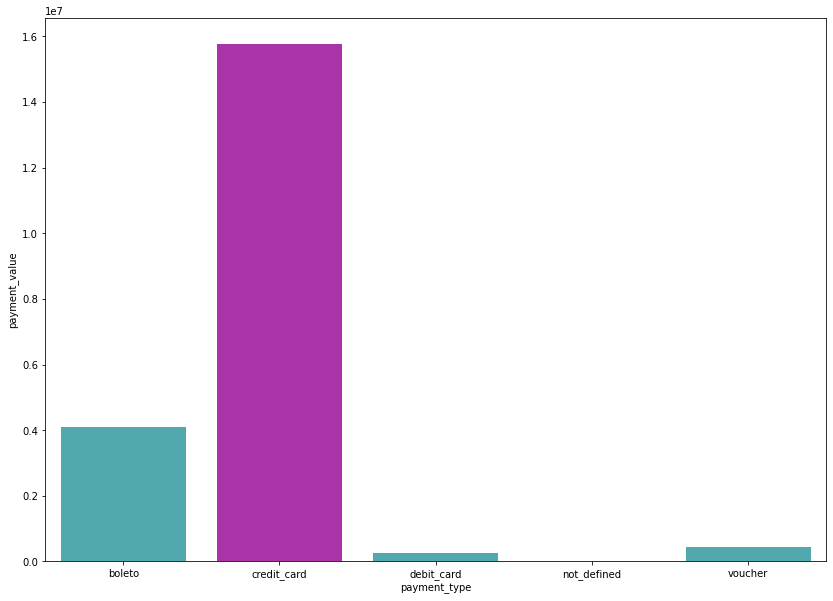

In [50]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(14, 10))

# plot a bar chart
bar =sns.barplot(
    x='payment_type', 
    y='payment_value', 
    data= df_meaningful, 
    estimator=sum, 
    ci=None, 
    color='#42b7bd');

patch_h = [patch.get_height() for patch in bar.patches]   
# patch_h contains the heights of all the patches now

idx_tallest = np.argmax(patch_h)   
# np.argmax return the index of largest value of the list

bar.patches[idx_tallest].set_facecolor('#a834a8')  

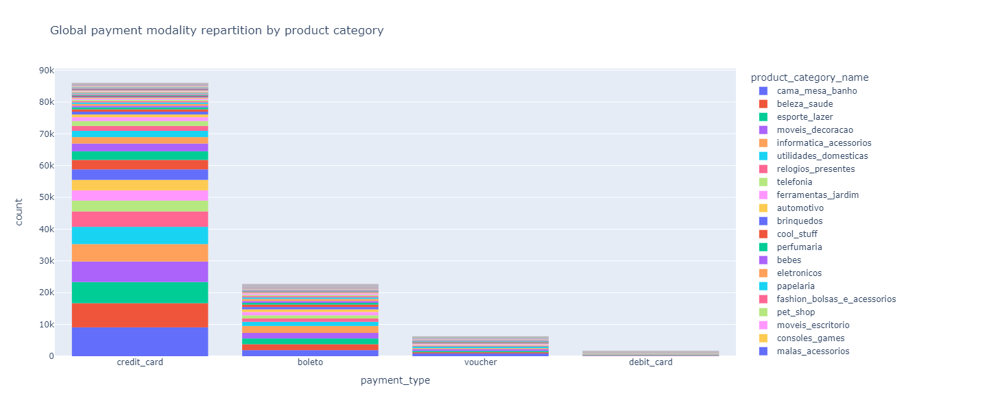

In [51]:
PAYMENT_MODALITY = ('credit_card', 'boleto', 'voucher', 'debit_card')
PRODUCT_CATEGORY = tuple(df_meaningful['product_category_name'].value_counts().index)

# Display the payment modality distribution per product category"
fig = px.histogram(df_meaningful.loc[df_meaningful['product_category_name']!= 'other'].loc[df_meaningful['product_category_name'].notnull() & df_meaningful['payment_type'].notnull()],
    x='payment_type',
    category_orders={'payment_type': PAYMENT_MODALITY, 'product_category_name': PRODUCT_CATEGORY},
    color='product_category_name',
    title='Global payment modality repartition by product category',
    width=1200,
    height=600,
)
fig.show()

We see that among the products listed, the distribution of products by payment modality is not comparable. There is an over-representation of the "credit_card" modality, and a hugh under-representation of the "debit_card" modality. We also see which product categories each modality is composed of. For example, there are many "cama_mesa_banho" among "credit_card" modality. 

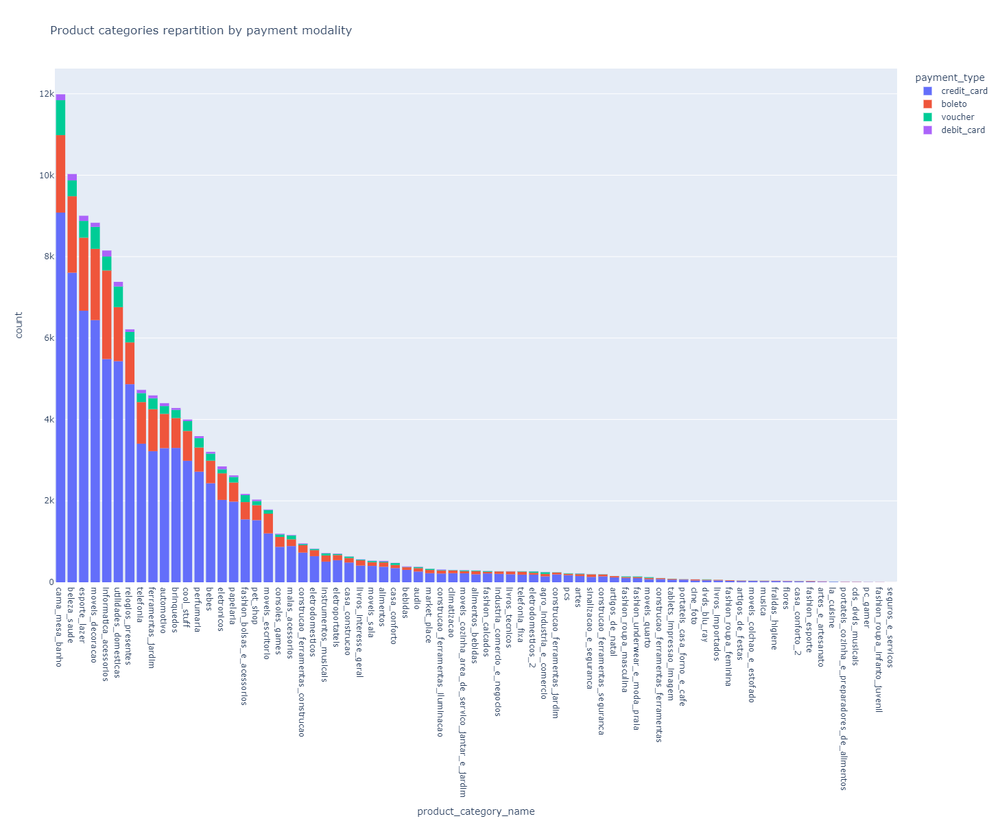

In [52]:
PAYMENT_MODALITY = ('credit_card', 'boleto', 'voucher', 'debit_card')
PRODUCT_CATEGORY = tuple(df_meaningful['product_category_name'].value_counts().index)

fig = px.histogram(df_meaningful.loc[df_meaningful['product_category_name'].notnull() & df_meaningful['payment_type'].notnull()],
    x='product_category_name',
    category_orders={'payment_type': PAYMENT_MODALITY, 'product_category_name': PRODUCT_CATEGORY},
    color='payment_type',
    title='Product categories repartition by payment modality',
    width=1200,
    height=1200,
)
fig.show()

Similarly, we see the same tendence as before. We can see the 19 products most selled.

#### Geografical location importance

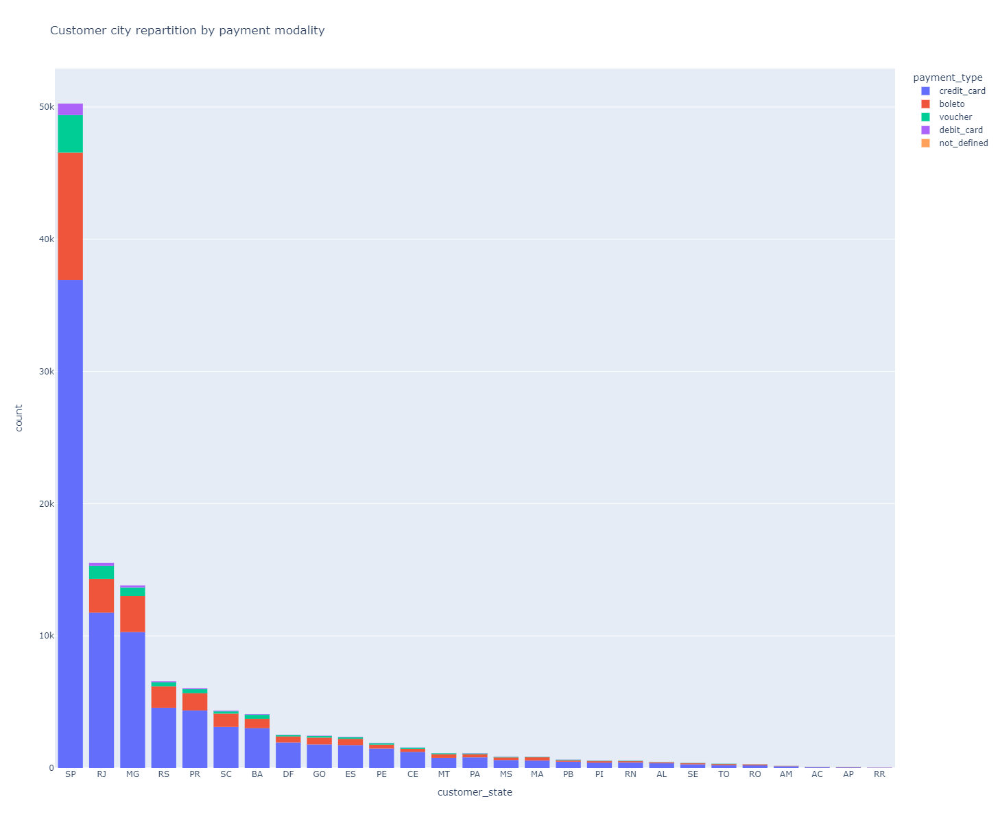

In [53]:
PAYMENT_MODALITY = ('credit_card', 'boleto', 'voucher', 'debit_card')
CUSTOMER_CITY = tuple(df_meaningful['customer_state'].value_counts().index)

fig = px.histogram(df_meaningful.loc[df_meaningful['customer_state'].notnull() & df_meaningful['payment_type'].notnull()],
    x='customer_state',
    category_orders={'payment_type': PAYMENT_MODALITY, 'customer_state': CUSTOMER_CITY},
    color='payment_type',
    title='Customer city repartition by payment modality',
    width=1200,
    height=1200,
)
fig.show()

We observe that most of the purchase have been done in 7 states. Moreover, credit card is the most used payment modality in the entire set of states

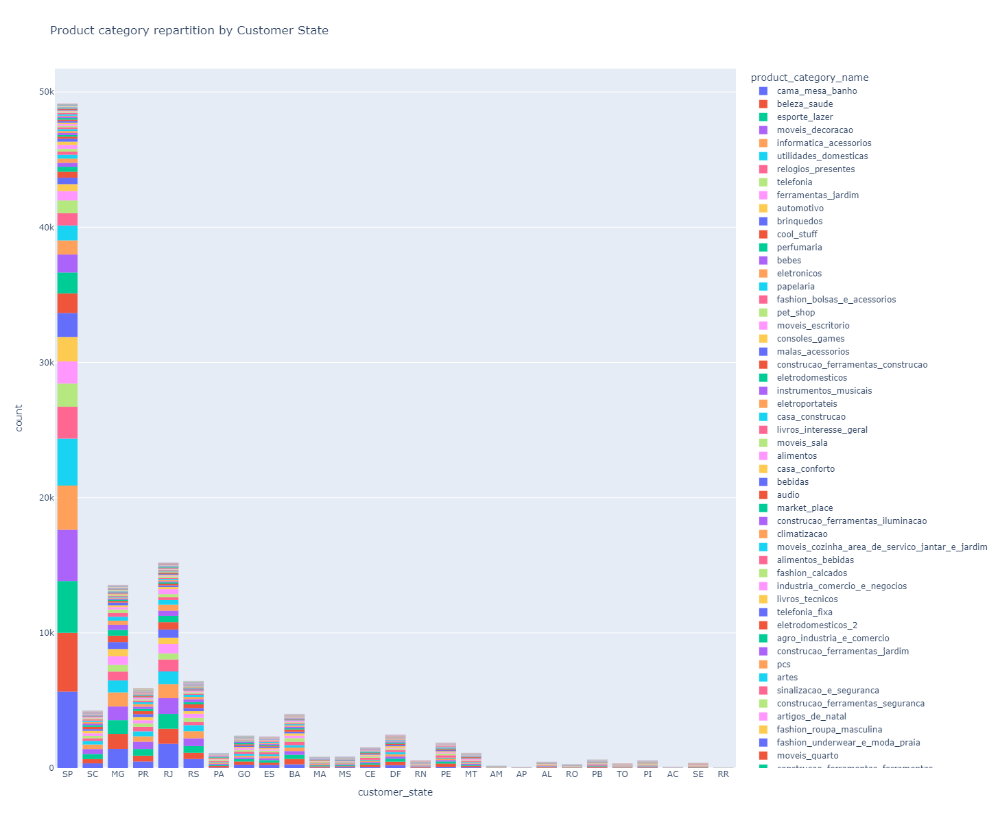

In [55]:
#PAYMENT_MODALITY = ('credit_card', 'boleto', 'voucher', 'debit_card')
CUSTOMER_CITY = df_meaningful['customer_state']
PRODUCT_CATEGORY = tuple(df_meaningful['product_category_name'].value_counts().index)

fig = px.histogram(df_meaningful.loc[df_meaningful['product_category_name'].notnull() & df_meaningful['customer_state'].notnull()],
                  #(df_meaningful.loc[df_meaningful['customer_state'].notnull() & df_meaningful['payment_type'].notnull()],                   
    x='customer_state',
    category_orders={'product_category_name': PRODUCT_CATEGORY, 'customer_state': CUSTOMER_CITY,},
    color='product_category_name',
    title='Product category repartition by Customer State',
    width=1200,
    height=1200,
)
fig.show()

We observe that among different states, the most selled products are cama_mesa_banho, beleza_saude and esporte_laser

### Feature Enginering with Time
Since, missing values' proportion is around 3%, Null Values from customer date feature will be filled with forward-fill method. This method, propagate the previous value forward


In [58]:
#merged_orders_payments_df

In [59]:
orders_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26


In [60]:
orders_df['order_delivered_customer_date']= orders_df['order_delivered_customer_date'].fillna(method='ffill')
orders_df['order_delivered_customer_date'].isnull().sum()

0

#### Delivery time

We will analyse the delivery time and estimate the Average Difference Days per Week 

In [61]:
# We will create Delivered time and Estimate time features 
orders_df['delivered_time']=pd.to_datetime(orders_df['order_delivered_customer_date'],
                                            format='%Y-%m-%d').dt.date
orders_df['estimate_time']=pd.to_datetime(orders_df['order_estimated_delivery_date'], 
                                           format='%Y-%m-%d').dt.date

C:\Users\ezequ\AppData\Local\Temp/ipykernel_18712/696836311.py:11: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.



Text(0.5, 1.0, 'Average Difference Days per Week')

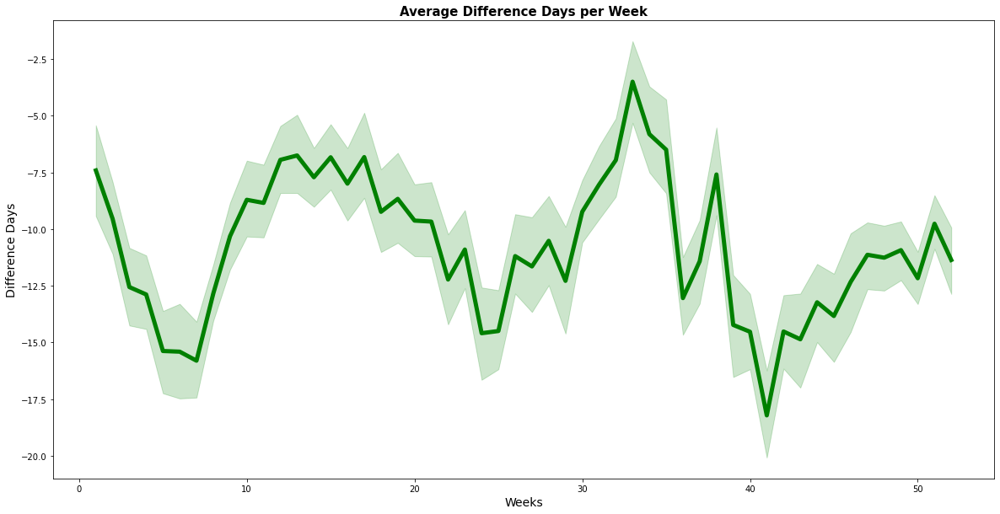

In [63]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime

# Weekly feature created based on order delivered customer date

orders_df['weekly']=pd.to_datetime(orders_df['order_delivered_customer_date'],
                                    format='%Y-%m-%d').dt.week

# Yearly feature created based on order delivered customer date

orders_df['yearly']=pd.to_datetime(orders_df['order_delivered_customer_date'])\
                    .dt.to_period('M')
orders_df['yearly']= orders_df['yearly'].astype(str)

# Finding different days of delivered and estimated times.

orders_df['diff_days']= orders_df['delivered_time']-orders_df['estimate_time']
orders_df['diff_days']= orders_df['diff_days'].dt.days

plt.figure(figsize=(20,10))
sns.lineplot(x='weekly', y='diff_days', data=orders_df, color="g", linewidth=5,
            markers=True,dashes=False, estimator='mean')

plt.xlabel("Weeks", size=14)
plt.ylabel("Difference Days", size=14)
plt.title("Average Difference Days per Week",size=15, weight='bold')

Above graph shows the earliest and latest deliveries. According to that, we can say that all deliveries made before their estimated date.

* The earliest deliveries have been made in October. It means that this month is the least intensive period in those years.

* Latest deliveries have been made at the end of June and beginning of August. It means that this time is the most intensive period in those years.

### RFM variables

We will create the RFM variable and check the distribution of each of them

In [64]:
# Compute the sum of the payment values for each order
merged_orders_payments_df = (
    orders_df[["order_id", "customer_id", "order_purchase_timestamp"]]
    .merge(
        order_payments_df[["order_id", "payment_value"]],
        how="left",
        left_on="order_id",
        right_on="order_id",
        validate="1:m",
    )
    .groupby("order_id")
    .agg(
        customer_id=("customer_id", "first"),
        order_purchase_timestamp=("order_purchase_timestamp", "first"),
        payment_value=("payment_value", "sum"),  # Total order value
    )
)

# Compute the RFM variables
rfm_df = (
    customers_df[["customer_id", "customer_unique_id"]]
    .merge(
        merged_orders_payments_df,
        how="left",
        left_on="customer_id",
        right_on="customer_id",
        validate="1:1",
    )
    .groupby("customer_unique_id")
    .agg(
        recency=(  # Recency : last purchase date
            "order_purchase_timestamp",
            "max",
        ),
        frequency=(  # Frequency : total number of purchases
            "customer_id",
            "count",
        ),
        monetary=("payment_value", "mean"),  # Monetary : average purchase value
    )
)

# Recency : Transform last purchase date to days since last purchase (from the very last order recorded)
rfm_df["recency"] = (
    (rfm_df["recency"] - rfm_df["recency"].max()) / np.timedelta64(1, "D")
).values

rfm_df.describe(include="all", datetime_is_numeric=True)

,recency,frequency,monetary
count,96096.000000,96096.000000,96096.000000
mean,-288.201370,1.034809,161.400116
std,153.416318,0.214384,222.307531
min,-772.843738,1.000000,0.000000
25%,-397.351398,1.000000,62.457500
50%,-268.910440,1.000000,105.825000
75%,-163.885744,1.000000,177.210000
max,0.000000,17.000000,13664.080000


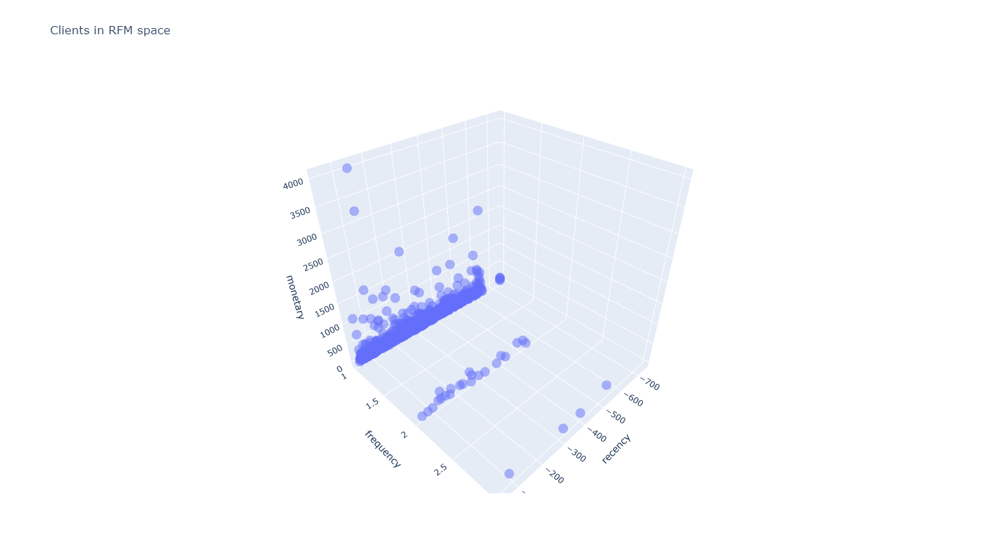

In [65]:
# Plot the RFM variables scatter matrix to see their correlation

fig = px.scatter_3d(
    rfm_df.sample(  # sample of the data for performances reasons
        n=1000,
        random_state=42,
    ),
    x="recency",
    y="frequency",
    z="monetary",
    title="Clients in RFM space",
    opacity=0.5,
    width=1200,
    height=800,
)
fig.show()


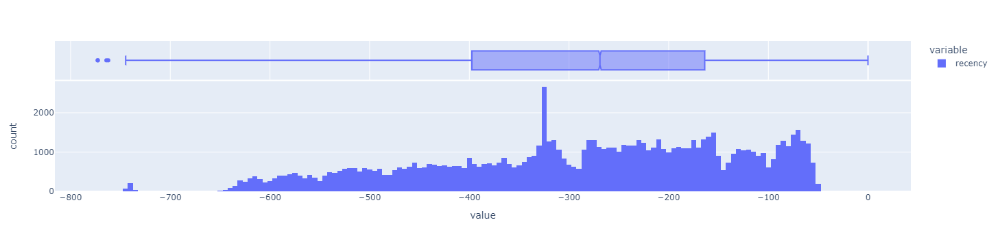

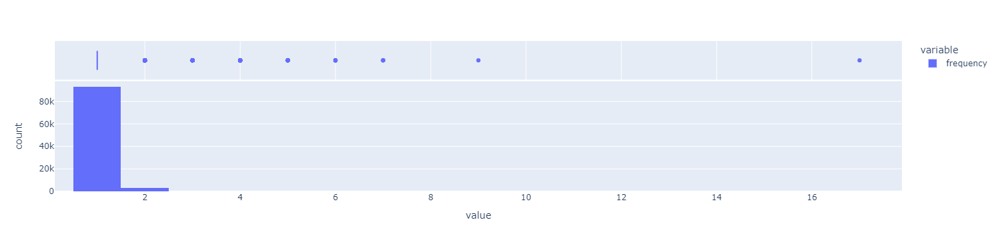

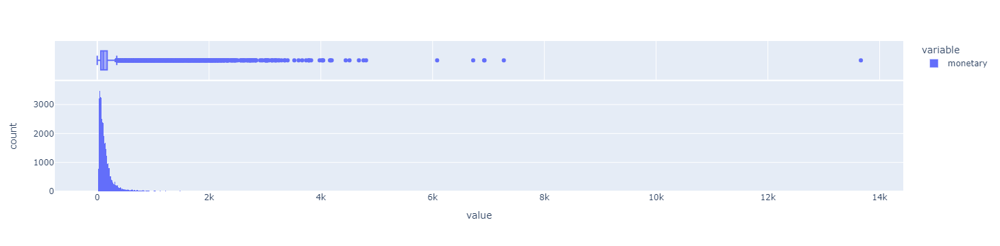

In [66]:
# Plot the RFM variables histograms and boxes with Plotly
for col in rfm_df.columns:
    fig = px.histogram(
        rfm_df[col],
        marginal="box",
        width=800,
    )
    fig.show()

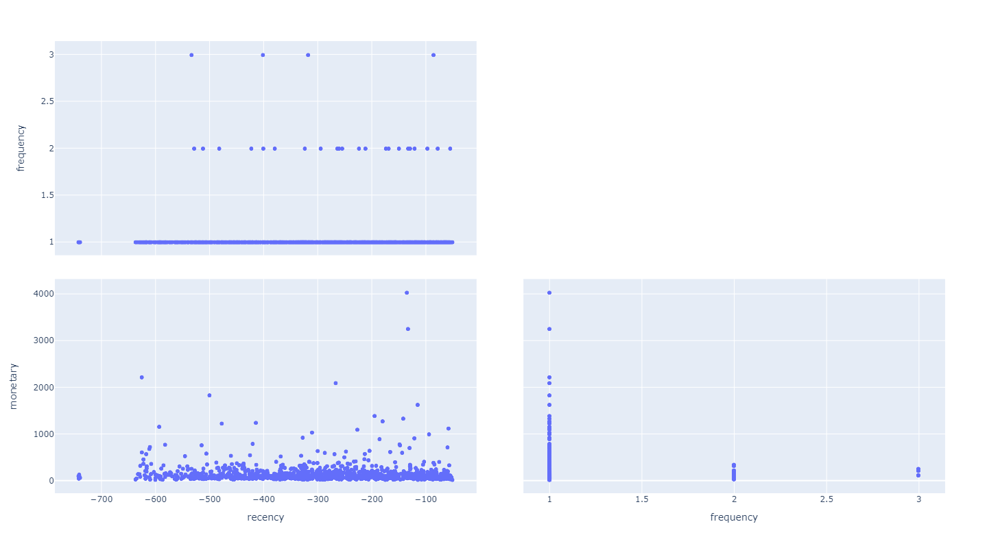

In [67]:
fig = px.scatter_matrix(
        rfm_df.sample(  # sample of the data for performances reasons
            n=1000,
            random_state=42,
        ),
        width=1200,
        height=800,
    )
fig.update_traces(
    diagonal_visible=False,
    showupperhalf=False,
)
fig.show()

We see that the number of purchases tends to increase over time. Most (93%) of the customers who buy have only made one purchase. The average basket is 161 Reals.